In [1]:
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature

In [2]:
data = xr.open_dataset('/Users/jeppegrejspetersen/Code/Final_project_AppML/era5/era5_1940_temperature_2m.nc')

In [3]:
data

<xarray.Dataset> Size: 508MB
Dimensions:     (valid_time: 366, latitude: 241, longitude: 1440)
Coordinates:
    number      int64 8B ...
  * latitude    (latitude) float64 2kB 90.0 89.75 89.5 89.25 ... 30.5 30.25 30.0
  * longitude   (longitude) float64 12kB -180.0 -179.8 -179.5 ... 179.5 179.8
  * valid_time  (valid_time) datetime64[ns] 3kB 1940-01-01 ... 1940-12-31
Data variables:
    t2m         (valid_time, latitude, longitude) float32 508MB ...
Attributes:
    GRIB_centre:             ecmf
    GRIB_centreDescription:  European Centre for Medium-Range Weather Forecasts
    GRIB_subCentre:          0
    Conventions:             CF-1.7
    institution:             European Centre for Medium-Range Weather Forecasts
    history:                 2025-05-16T10:52 GRIB to CDM+CF via cfgrib-0.9.1...

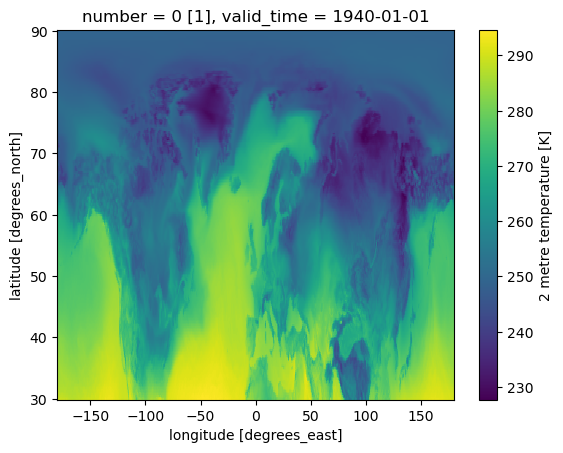

In [4]:
data['t2m'].isel(valid_time = 0).plot()

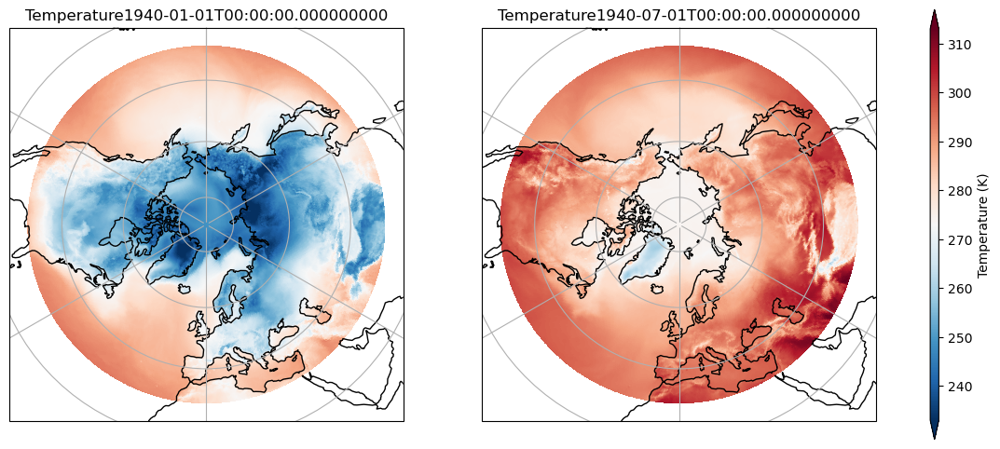

In [23]:
fig, axs = plt.subplots(ncols=2, figsize=(15, 6), subplot_kw={'projection': ccrs.NorthPolarStereo()})

for ax in axs.flatten():
    ax.coastlines()
    # ax.add_feature(cfeature.LAND, edgecolor='black')
    ax.gridlines()

    ax.set_extent([-180, 180, 25, 90], ccrs.PlateCarree())

h = axs[0].pcolormesh(data.longitude, data.latitude, data['t2m'].isel(valid_time=0).values, shading='auto', transform=ccrs.PlateCarree(), cmap = 'RdBu_r', vmin = 273-40, vmax = 273 + 40)

axs[0].set_title(f"Temperature{data['valid_time'].isel(valid_time=0).values}")

axs[1].pcolormesh(data.longitude, data.latitude, data['t2m'].isel(valid_time=365//2).values, shading='auto', transform=ccrs.PlateCarree(), cmap = 'RdBu_r', vmin = 273-40, vmax = 273 + 40)
axs[1].set_title(f"Temperature{data['valid_time'].isel(valid_time=365//2).values}")


##plot colorbar to the right of the figure
cbar = fig.colorbar(h, ax=axs, orientation='vertical', pad=0.05, aspect=50, extend='both')
cbar.set_label('Temperature (K)')


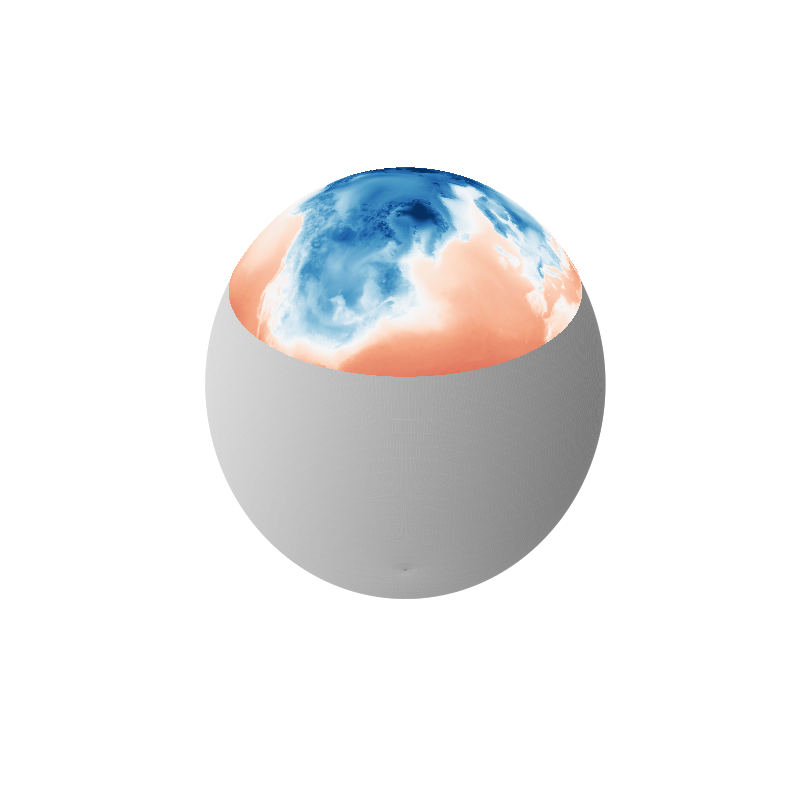

In [6]:
from mpl_toolkits.mplot3d import Axes3D
import numpy as np

fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(111, projection='3d')

# Create a sphere
u = np.linspace(0, 2 * np.pi, 1440)
v = np.linspace(0, np.pi, 241)
x = np.outer(np.cos(u), np.sin(v))
y = np.outer(np.sin(u), np.sin(v))
z = np.outer(np.ones(np.size(u)), np.cos(v))

# Map data onto the sphere
lon, lat = np.meshgrid(data.longitude, data.latitude)
lon_rad = np.radians(lon)
lat_rad = np.radians(90 - lat)

# Convert spherical to Cartesian coordinates
x_data = np.sin(lat_rad) * np.cos(lon_rad)
y_data = np.sin(lat_rad) * np.sin(lon_rad)
z_data = np.cos(lat_rad)

# Normalize the data for coloring
temperature = data['t2m'].isel(valid_time=0).values
norm = plt.Normalize(vmin=273-40, vmax=273+40)
colors = plt.cm.RdBu_r(norm(temperature))

# Plot the sphere with data
ax.plot_surface(x, y, z, rstride=5, cstride=5, color='lightgray', alpha=0.5, edgecolor='none')
ax.plot_surface(x_data, y_data, z_data, facecolors=colors, rstride=1, cstride=1, antialiased=False, shade=False)

# Add colorbar
# mappable = plt.cm.ScalarMappable(cmap='RdBu_r', norm=norm)
# mappable.set_array(temperature)
# cbar = fig.colorbar(mappable, shrink=0.5, aspect=10)
# cbar.set_label('Temperature (K)')

ax.set_box_aspect([1, 1, 1])  # Equal aspect ratio
ax.set_axis_off()
plt.show()

In [9]:
import numpy as np
import plotly.graph_objects as go

# 1. Extract 1D arrays of longitude and latitude
lon = data.longitude.values  # shape (1440,)
lat = data.latitude.values   # shape (241,)

# 2. Create 2D meshgrid of lon and lat
lon2d, lat2d = np.meshgrid(lon, lat)  # both shape (241, 1440)

# 3. Convert to radians
lon_rad = np.deg2rad(lon2d)
lat_rad = np.deg2rad(lat2d)

# 4. Compute Cartesian coordinates for the sphere
x = np.cos(lat_rad) * np.cos(lon_rad)
y = np.cos(lat_rad) * np.sin(lon_rad)
z = np.sin(lat_rad)

# 5. Extract temperature data corresponding to the meshgrid
temp = data['t2m'].isel(valid_time=0).values  # shape should be (241, 1440)

# 6. Define temperature range for coloring
tmin, tmax = 233, 313  # Example: 233K to 313K




# 7. Create Plotly Surface plot
fig = go.Figure(data=go.Surface(
    x=x, y=y, z=z,
    surfacecolor=temp,
    colorscale='RdBu_r',
    cmin=tmin, cmax=tmax,
    colorbar=dict(title='Temperature (K)')
))




# 8. Adjust layout for a globe-like appearance
fig.update_layout(
    scene=dict(
        xaxis=dict(showbackground=False, showticklabels=False),
        yaxis=dict(showbackground=False, showticklabels=False),
        zaxis=dict(showbackground=False, showticklabels=False),
        aspectmode='data'
    ),
    margin=dict(l=0, r=0, b=0, t=0)
)

# 9. Display the interactive globe
fig.show()



In [10]:
import numpy as np
import plotly.graph_objects as go

# 1. Generate the base sphere
theta = np.linspace(0, 2 * np.pi, 100)
phi = np.linspace(0, np.pi, 100)
theta, phi = np.meshgrid(theta, phi)

# Sphere coordinates
x_sphere = np.cos(theta) * np.sin(phi)
y_sphere = np.sin(theta) * np.sin(phi)
z_sphere = np.cos(phi)

# 2. Extract your temperature data
lon = data.longitude.values  # shape (1440,)
lat = data.latitude.values   # shape (241,)

# Create 2D meshgrid of lon and lat
lon2d, lat2d = np.meshgrid(lon, lat)

# Convert to radians
lon_rad = np.deg2rad(lon2d)
lat_rad = np.deg2rad(lat2d)

# Compute Cartesian coordinates for the temperature surface
x_temp = np.cos(lat_rad) * np.cos(lon_rad)
y_temp = np.cos(lat_rad) * np.sin(lon_rad)
z_temp = np.sin(lat_rad)

# Extract temperature data
temp = data['t2m'].isel(valid_time=0).values  # shape should be (241, 1440)

# Define temperature range for coloring
tmin, tmax = 233, 313  # Example: 233K to 313K

# 3. Create Plotly figure
fig = go.Figure()

# Add base sphere
fig.add_trace(go.Surface(
    x=x_sphere,
    y=y_sphere,
    z=z_sphere,
    colorscale='Greys',
    opacity=0.5,
    showscale=False
))

# Add temperature surface
fig.add_trace(go.Surface(
    x=x_temp,
    y=y_temp,
    z=z_temp,
    surfacecolor=temp,
    colorscale='RdBu_r',
    cmin=tmin,
    cmax=tmax,
    colorbar=dict(title='Temperature (K)')
))

# Adjust layout for a globe-like appearance
fig.update_layout(
    scene=dict(
        xaxis=dict(showbackground=False, showticklabels=False),
        yaxis=dict(showbackground=False, showticklabels=False),
        zaxis=dict(showbackground=False, showticklabels=False),
        aspectmode='data'
    ),
    margin=dict(l=0, r=0, b=0, t=0)
)

# Display the interactive globe
fig.show()
